In [1]:
import numpy as np
import pandas as pd
import tqdm
import re
from lightfm import LightFM

/Users/emilgrigoryan/opt/anaconda3/lib/python3.8/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn(


In [2]:
! pip install lightfm

     |████████████████████████████████| 310 kB 1.5 MB/s eta 0:00:01
  Created wheel for lightfm: filename=lightfm-1.16-cp38-cp38-macosx_10_9_x86_64.whl size=436273 sha256=a8a664d7979c40b414230b8bf730692370473abbafd59e4e39e707d98cc5e6be
  Stored in directory: /Users/emilgrigoryan/Library/Caches/pip/wheels/ec/bb/51/9c487d021c1373b691d13cadca0b65b6852627b1f3f43550fa
Successfully built lightfm


In [4]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

In [5]:
Int = pd.read_csv('Interactions-3.csv')
items = pd.read_csv("items_with_text.csv")

In [6]:
items["picture_url"][12]

'https://img.mvideo.ru/Pdb/10010523b.jpg'

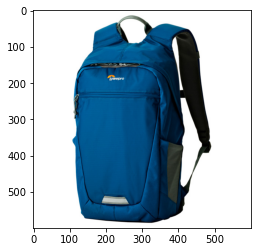

In [7]:
r = requests.get('https://img.mvideo.ru/Pdb/10010523b.jpg')
im = Image.open(BytesIO(r.content))
plt.imshow(im)

In [8]:
Int["page_type"].value_counts()

PRODUCT     602024
CART         35396
PURCHASE      8715
Name: page_type, dtype: int64

In [9]:
items.shape

(4185, 2)

In [10]:
Int = Int.merge(items[["picture_url", "text"]].drop_duplicates(), on=["picture_url"])

In [11]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Холодный старт

# Самые популярные

Посмотрим, какие товары у нас самые популярные в разных разрезах (просмотр / корзина / покупка) 

In [12]:
class Top():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_items(self):
        # Хотим получить в отсортированном порядке датафрейм - product_id, user_number
        items = self.interactions[self.interactions["page_type"] == "CART"]\
                                                .groupby("product_id")["vid"].count() \
                                                .reset_index() \
                                                .sort_values("vid", ascending=False)[:30]
        
        rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

In [13]:
T = Top(Int)

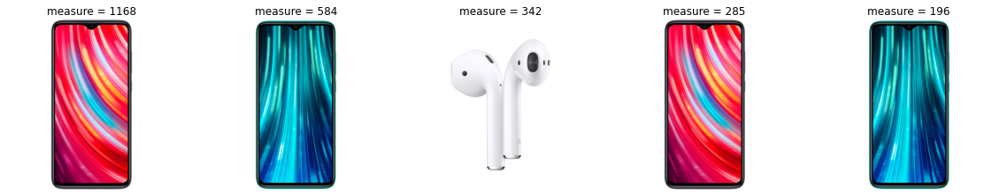

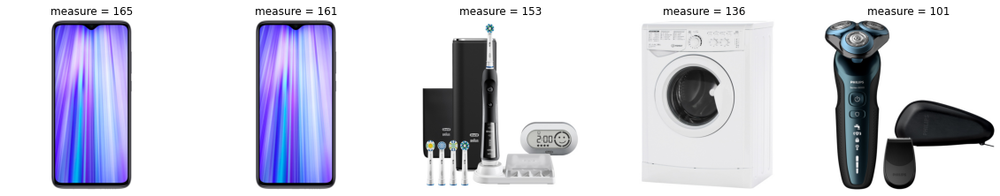

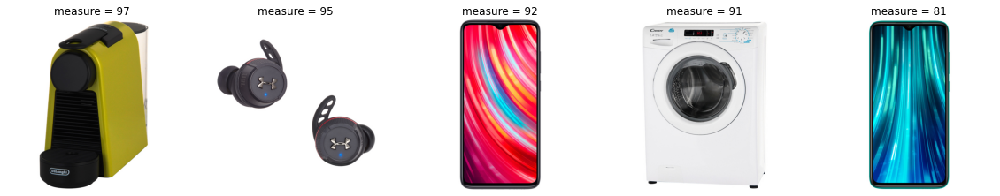

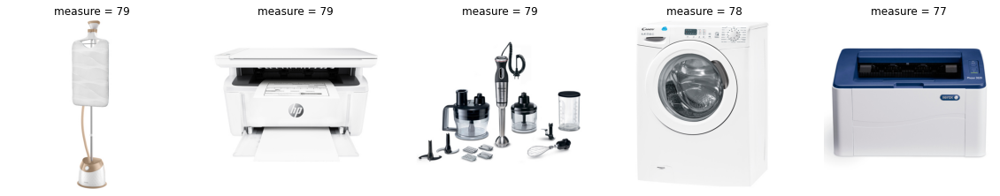

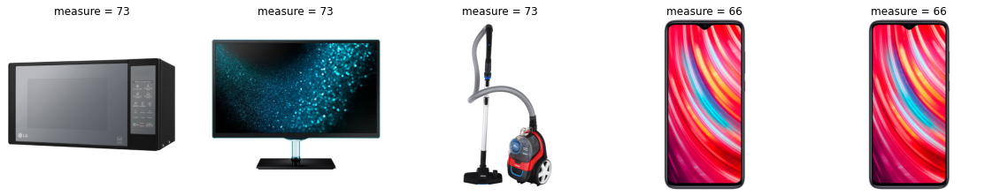

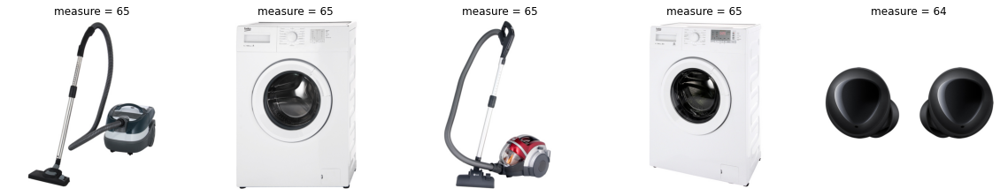

In [14]:
T.top_items()

# Cовстречаемость

In [138]:
Int_tmp = Int[["vid", "product_id"]].drop_duplicates()

In [139]:
Int_tmp.head()

,vid,product_id
0,0,0
5,1,0
6,2,0
10,21291,245
12,22367,245


In [141]:
user_products = Int_tmp.groupby(["vid"])["product_id"].apply(list).reset_index()

In [143]:
user_products[:3]

,vid,product_id
0,0,[0]
1,1,"[0, 42341]"
2,2,"[0, 48833, 37522, 49883, 42341, 48743]"


In [13]:
class Recomendations():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        # Для каждого пользователя собираем товары, с которыми он взамиодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]
        
        # Заводим словарь под товары
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза, то добавляем в список
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [144]:
cooc_rec = Recomendations(Int)
cooc_rec.coocurrency_count()

/Users/v.zhuravlyov/anaconda2/envs/notebook-6.0.1/lib/python3.7/site-packages/ipykernel_launcher.py:21: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


In [146]:
cooc_rec.cooc_rec.sort_values("measure", ascending=False)

,item1,item2,measure
228,1181,381,1214
229,381,1181,1214
709,381,384,1101
718,384,381,1101
6012,384,1181,905
...,...,...,...
55436,25317,10448,2
55437,25317,25316,2
55438,253,27324,2
55439,3453,27324,2


Для товара


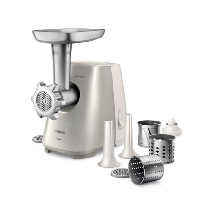

Такие рекомендации


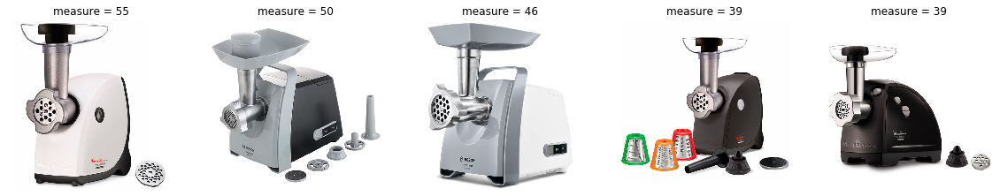

Something went wrong with https://img.mvideo.ru/Pdb/20031441b.jpg


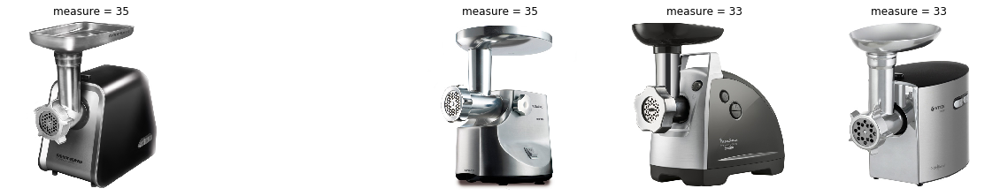

In [147]:
cooc_rec.get_rec(10)

Для товара


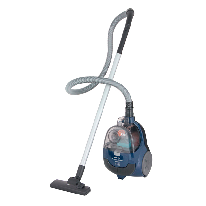

Такие рекомендации


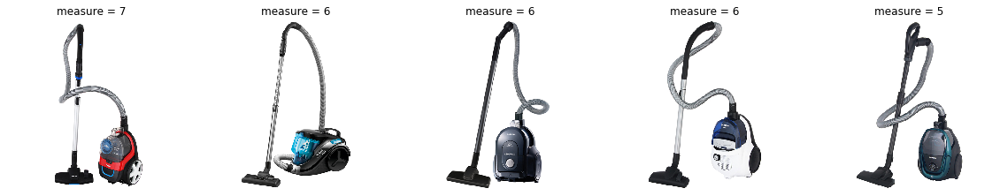

Something went wrong with https://img.mvideo.ru/Pdb/10018205b.jpg


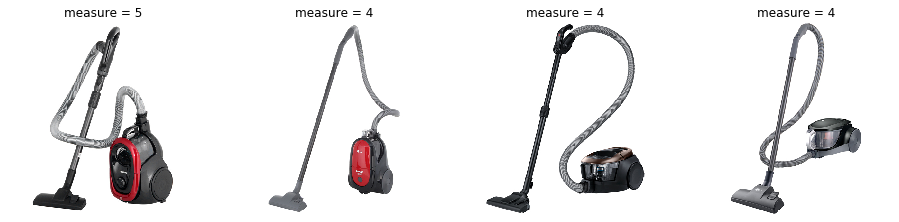

In [148]:
cooc_rec.get_rec(121)

Для товара


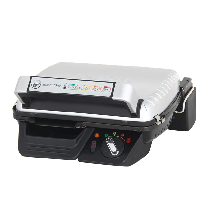

Такие рекомендации


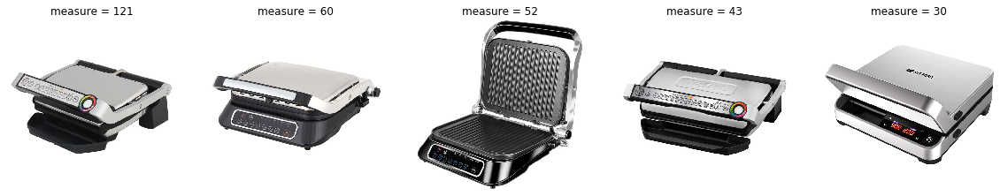

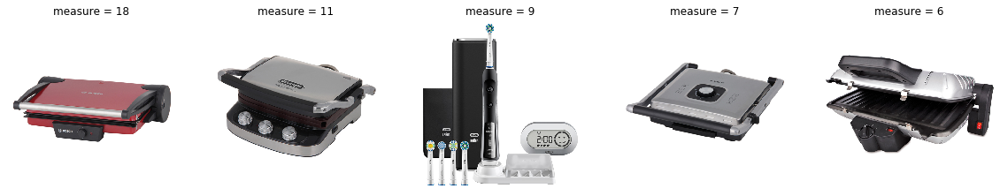

In [149]:
cooc_rec.get_rec(42)

Для товара


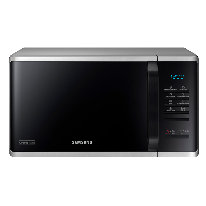

Такие рекомендации


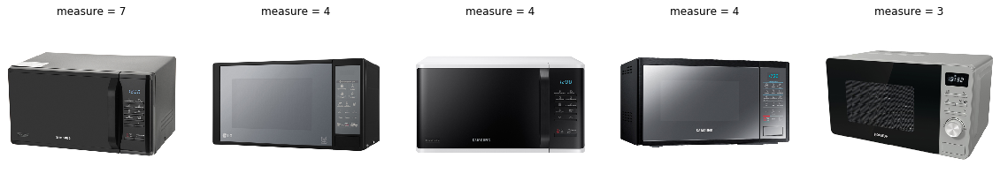

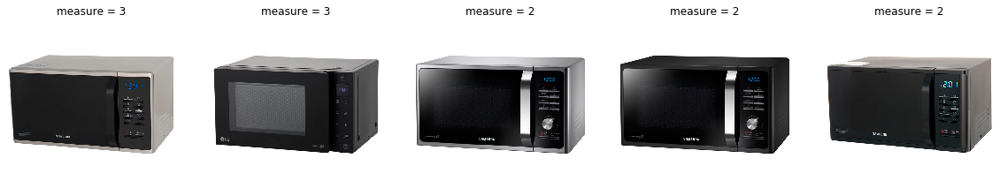

In [150]:
cooc_rec.get_rec(1111)

Для товара


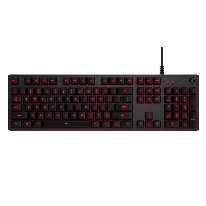

Такие рекомендации


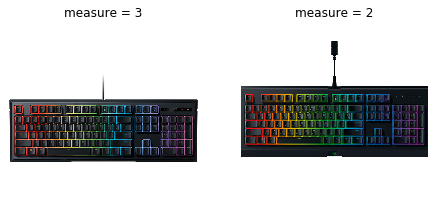

In [151]:
cooc_rec.get_rec(1236)

Для товара


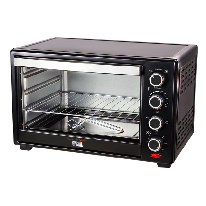

Такие рекомендации


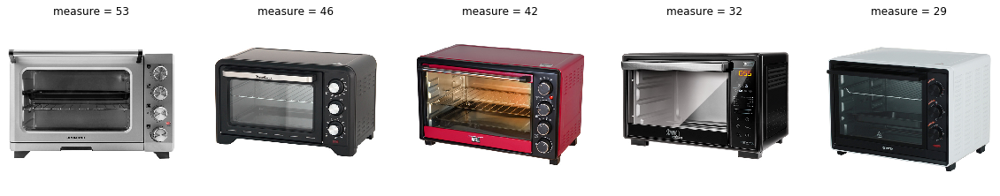

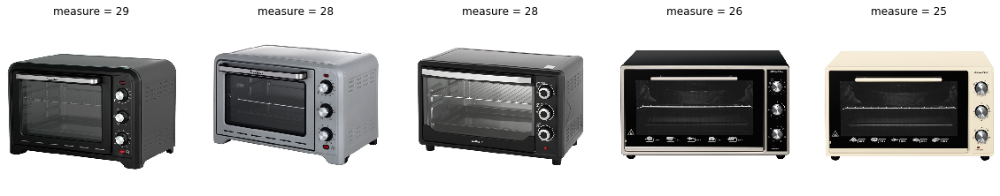

In [152]:
cooc_rec.get_rec(1362)

Для товара


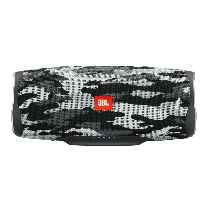

Такие рекомендации


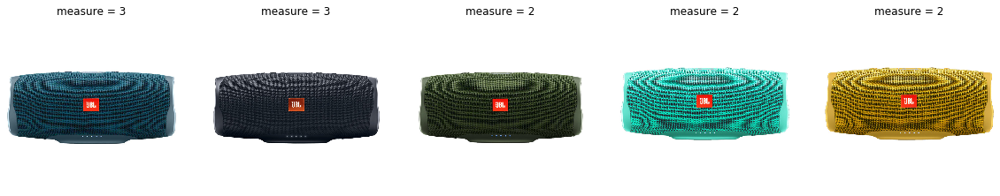

In [153]:
cooc_rec.get_rec(1002)

Для товара


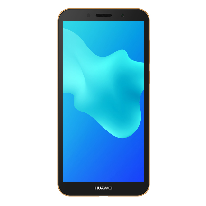

Такие рекомендации


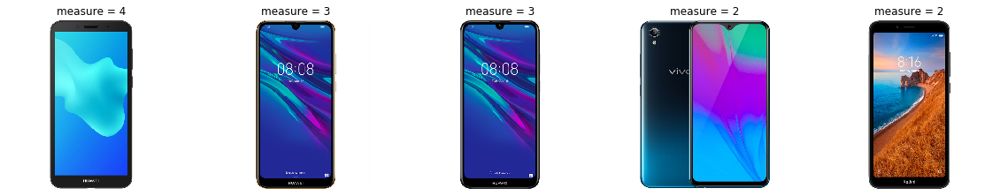

In [154]:
cooc_rec.get_rec(1245)

Для товара


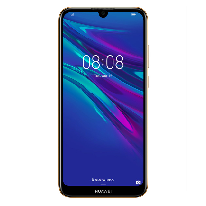

Такие рекомендации


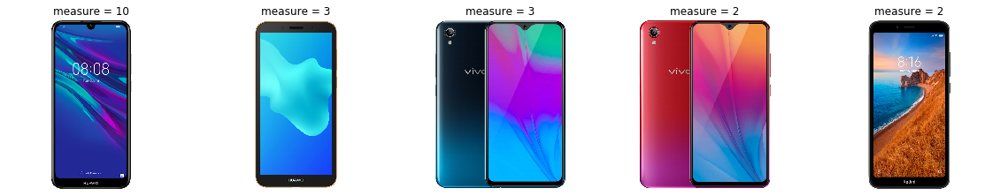

In [155]:
cooc_rec.get_rec(1247)

Для товара


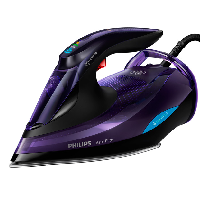

Такие рекомендации


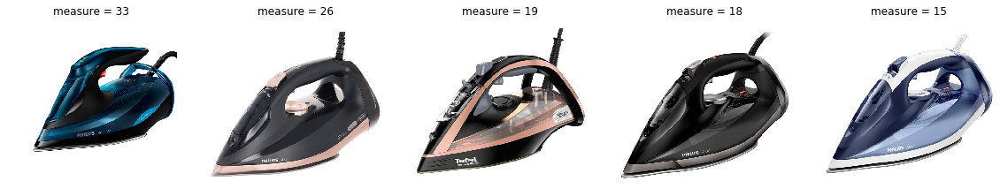

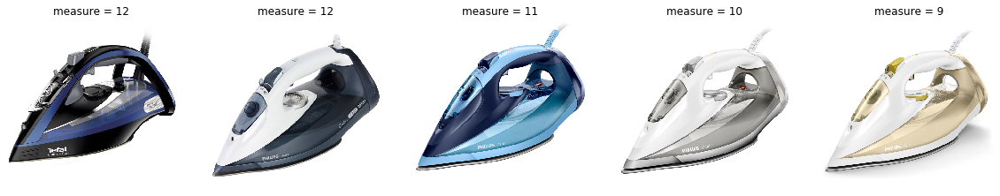

In [156]:
cooc_rec.get_rec(3453)

Для товара


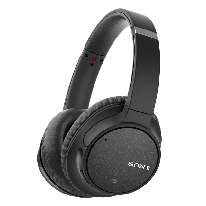

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/50117005b.jpg


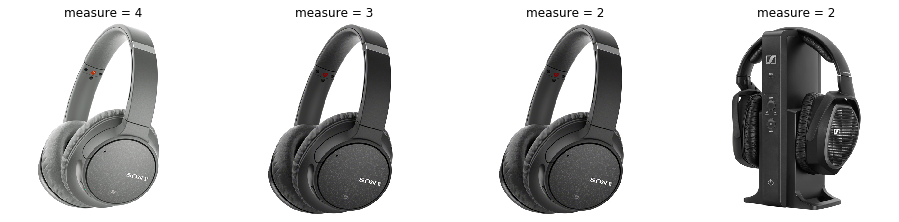

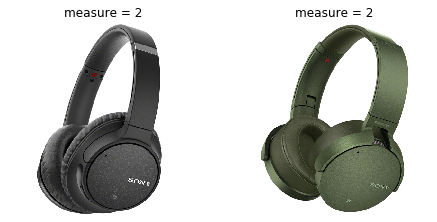

In [157]:
cooc_rec.get_rec(3445)

Для товара


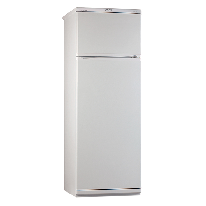

Такие рекомендации


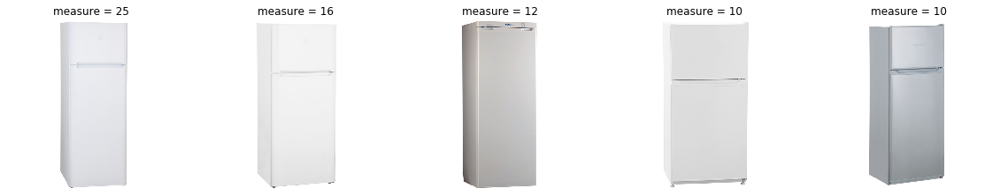

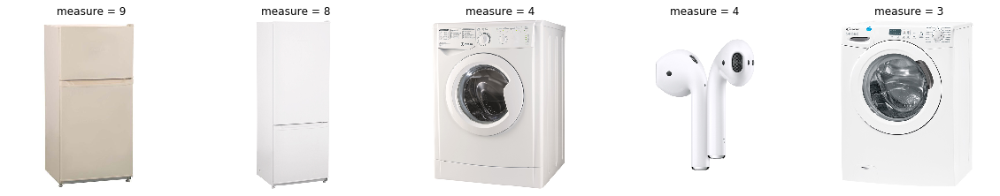

In [158]:
cooc_rec.get_rec(667)

In [ ]:
cooc_rec.get_rec(1231)

In [ ]:
cooc_rec.get_rec(1226)

In [ ]:
cooc_rec.get_rec(1212)

In [ ]:
cooc_rec.get_rec(631)

# Content-based

In [190]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions.drop_duplicates()
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):ф
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [165]:
" ".join(Int[Int["vid"] == 121]["text"])

'20061538 282 tia 14 450 indesit холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061745 106 cx 343 732 450 nordfrost холодильник холодильники с верхней морозильной камерой 20061753 151 cx 341 332 510 nordfrost холодильник холодильники с верхней морозильной камерой'

In [191]:
CB = Content_Based(items, Int)

In [192]:
CB.get_items_representation()

Для товара


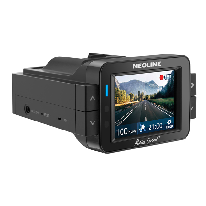

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/10008287b.jpg


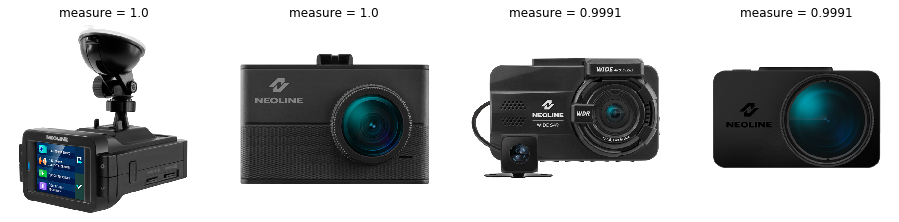

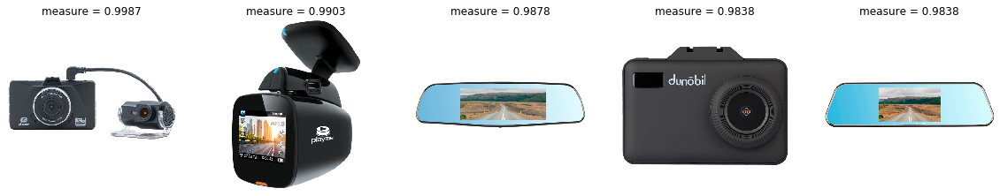

In [193]:
CB.get_rec_I2I(13)

Для товара


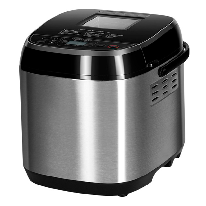

Такие рекомендации


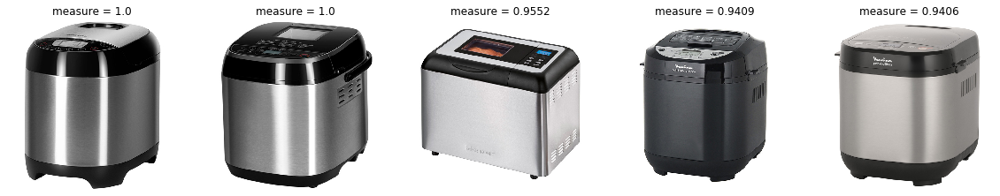

Something went wrong with https://img.mvideo.ru/Pdb/20047114b.jpg


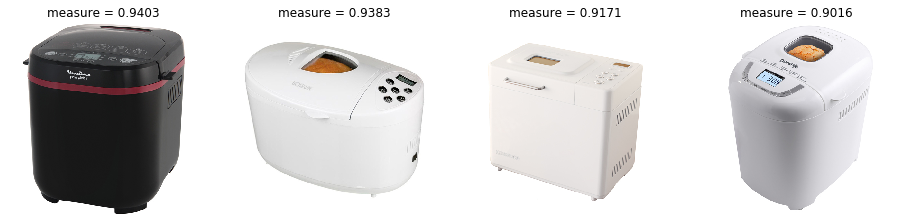

In [194]:
CB.get_rec_I2I(2145)

Для пользователя, который взаимодействовал с товарами


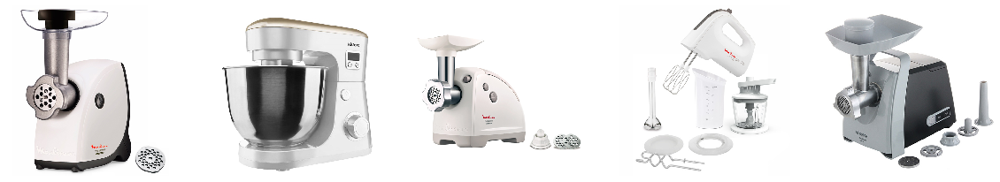

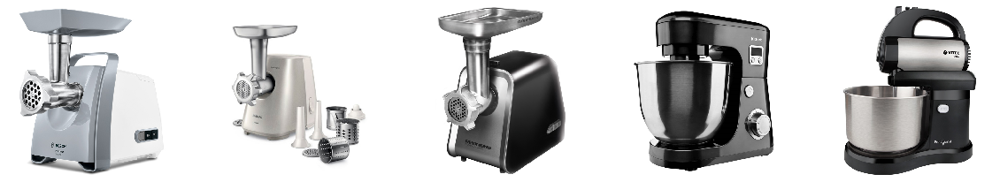

Такие рекомендации


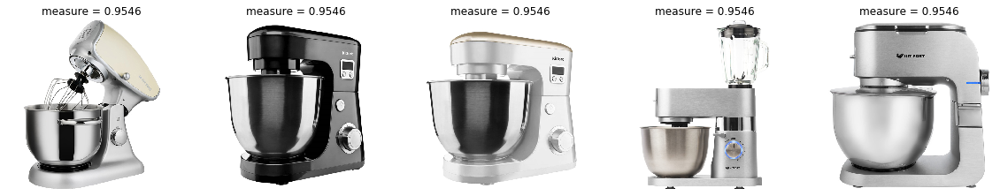

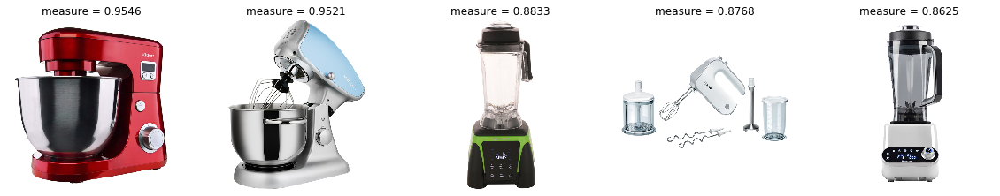

In [180]:
CB.get_rec_U2I(453)

Для пользователя, который взаимодействовал с товарами


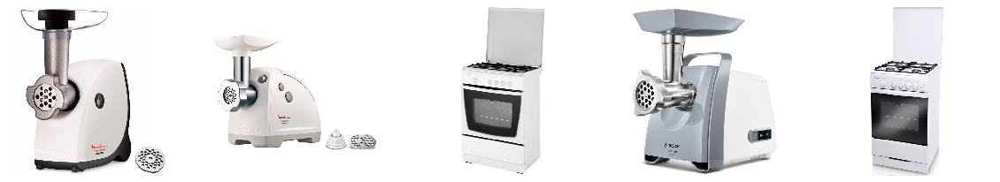

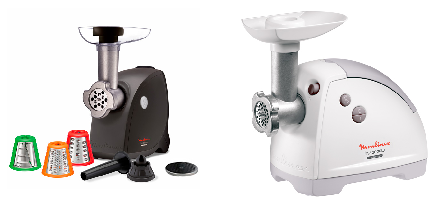

Такие рекомендации


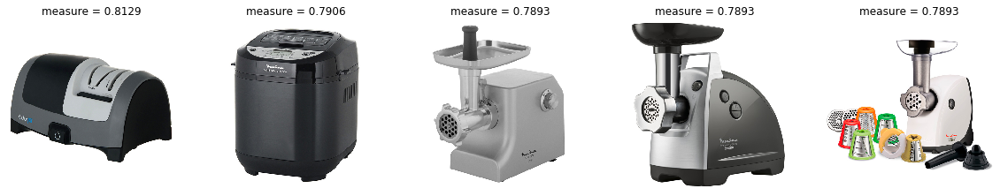

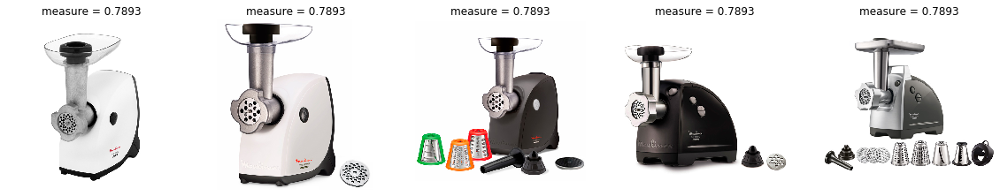

In [181]:
CB.get_rec_U2I(333)

Для пользователя, который взаимодействовал с товарами


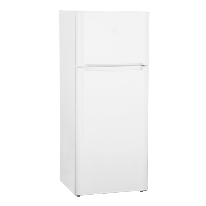

Такие рекомендации


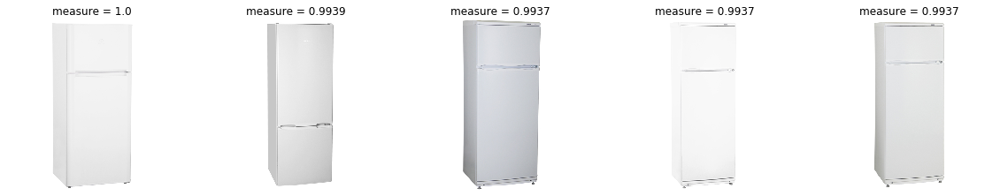

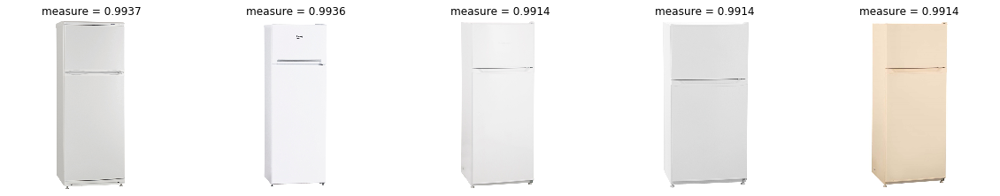

In [185]:
CB.get_rec_U2I(213)

Для пользователя, который взаимодействовал с товарами


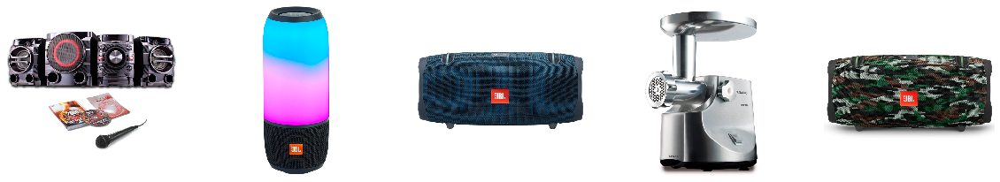

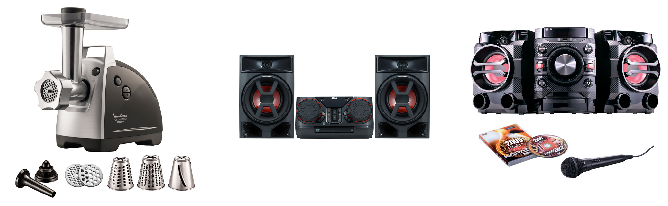

Такие рекомендации


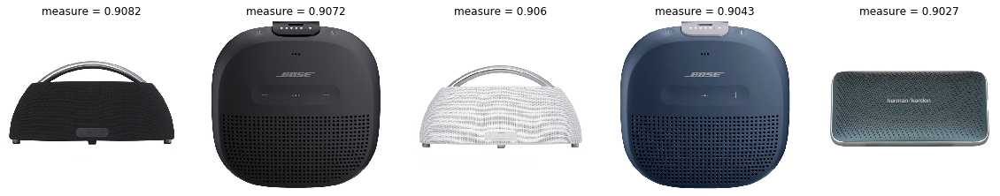

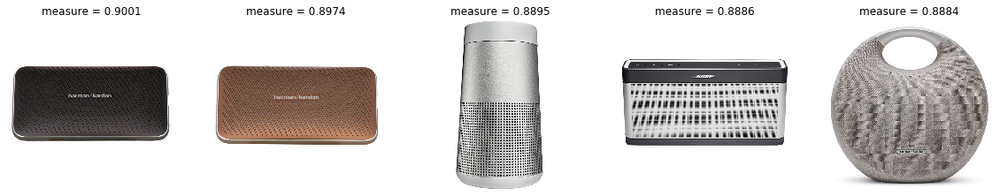

In [186]:
CB.get_rec_U2I(777)

Для пользователя, который взаимодействовал с товарами


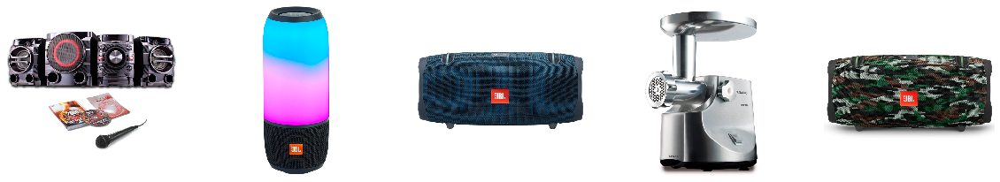

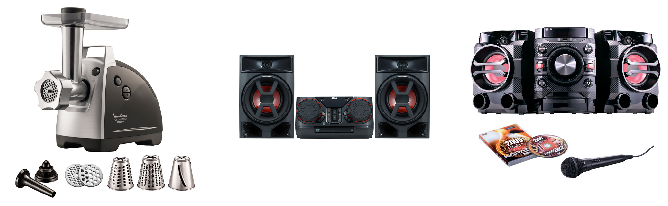

Такие рекомендации


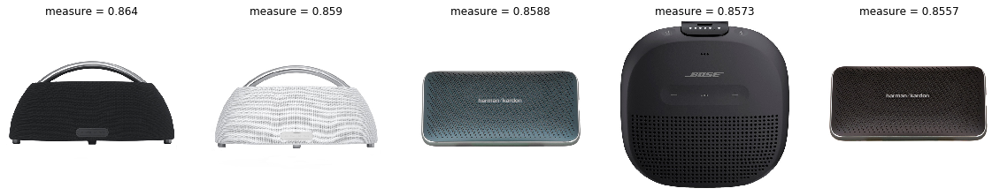

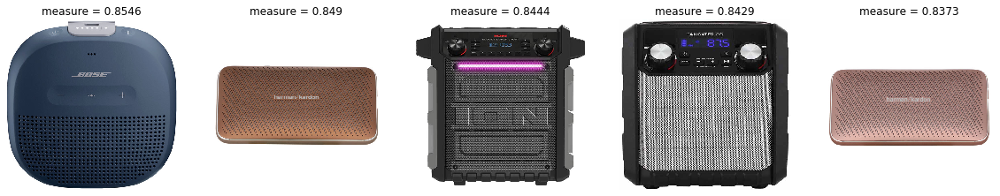

In [195]:
CB.get_rec_U2I(777)

# W2V recommendations

In [196]:
class W2V_REC():
    def __init__(self, interactions):
        self.interactions = interactions
        self.interactions["product_id"] = self.interactions["product_id"].astype(str)
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j

    def get_w2v(self):
        interactions_sentences = self.interactions.groupby(["vid"])["product_id"].apply(list).reset_index()
        self.model = gensim.models.Word2Vec(
                                        interactions_sentences["product_id"].apply(list).values,
                                        size=200,
                                        window=10,
                                        min_count=1,
                                        workers=10,
                                        iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        
    def avg_feature_vector(self, words):
        feature_vec = np.zeros(200, dtype='float32')
        n_words = 0
        for word in words:
            if word in self.index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, self.model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec
    
    def get_rec_I2I(self, i):
        i = str(i)
        metrics = [j[1] for j in self.model.wv.similar_by_word(i)]
        items = [j[0] for j in self.model.wv.similar_by_word(i)]
        print(u"Для товара")
        r = requests.get(self.content_dict[i])
        im = Image.open(BytesIO(r.content))
        plt.imshow(im)
        plt.axis('off')
        plt.show()
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

    def get_rec_U2I(self, i):
        user_items = list(self.interactions[self.interactions["vid"] == i]["product_id"].drop_duplicates())
        user_emb = self.avg_feature_vector(user_items)
        recs = self.model.wv.most_similar(positive=[user_emb], topn=10)
        metrics = [j[1] for j in recs]
        items = [j[0] for j in recs]
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(user_items, self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

In [197]:
w = W2V_REC(Int)
w.get_w2v()

Для товара


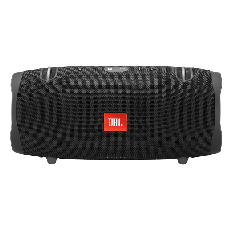

Такие рекомендации


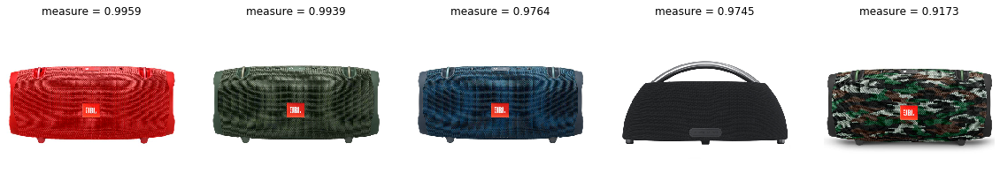

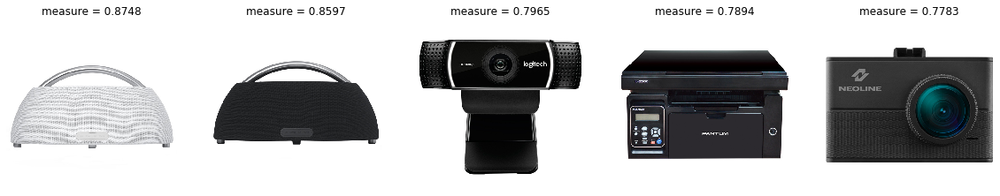

In [198]:
w.get_rec_I2I(0)

Для товара


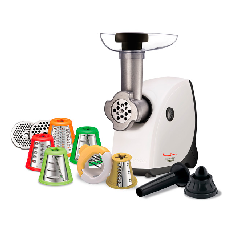

Такие рекомендации


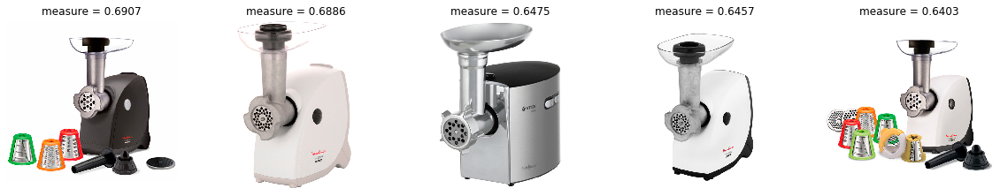

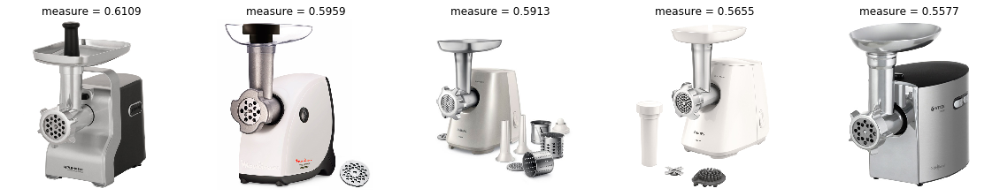

In [199]:
w.get_rec_I2I(13)

Для товара


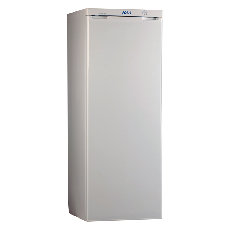

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/50044182b.jpg


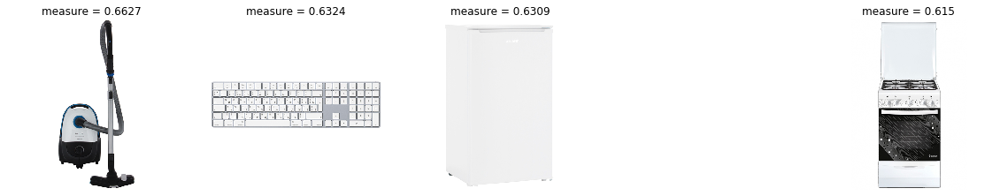

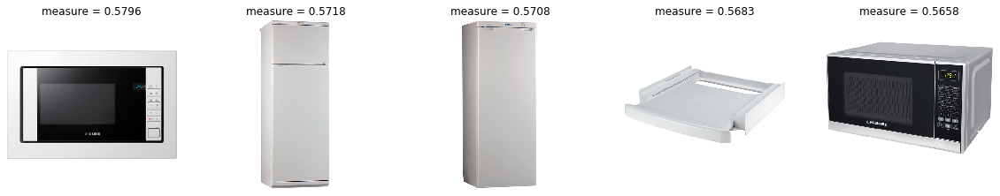

In [207]:
w.get_rec_I2I(666)

Для пользователя, который взаимодействовал с товарами


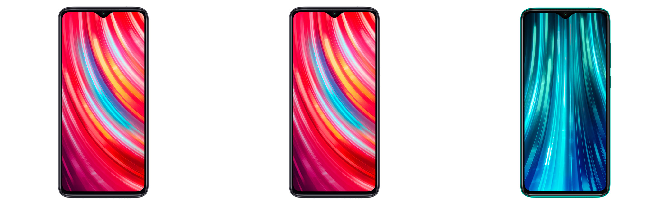

Такие рекомендации


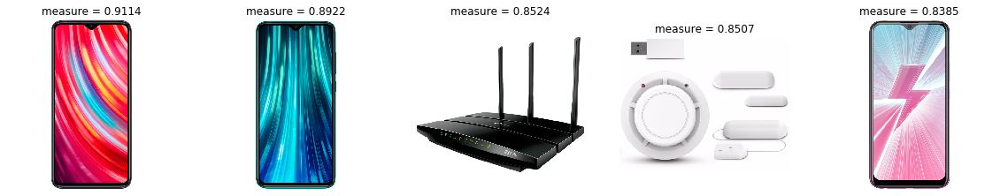

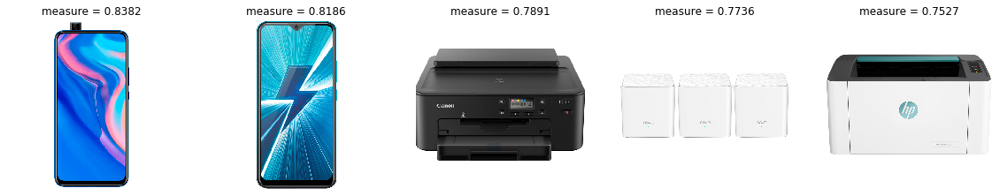

In [204]:
w.get_rec_U2I(42)

Для пользователя, который взаимодействовал с товарами


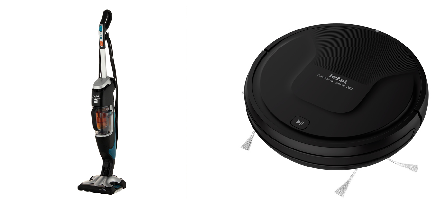

Такие рекомендации


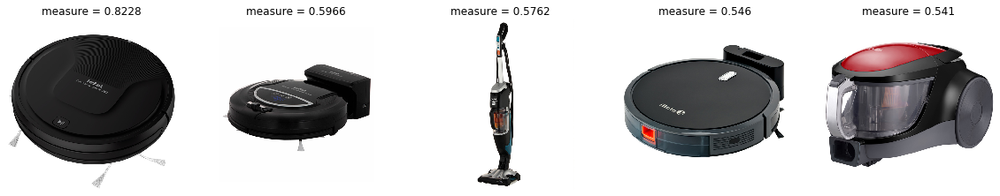

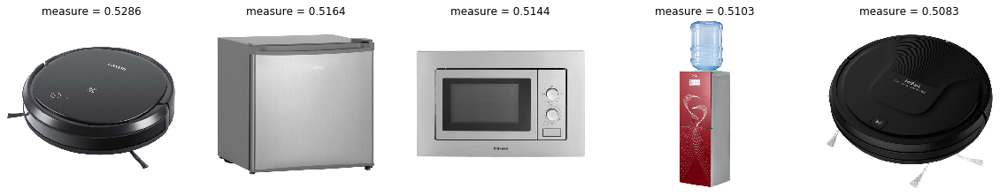

In [209]:
w.get_rec_U2I(4322)

Для пользователя, который взаимодействовал с товарами


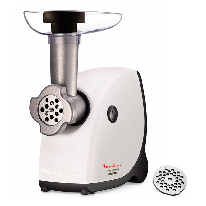

Такие рекомендации


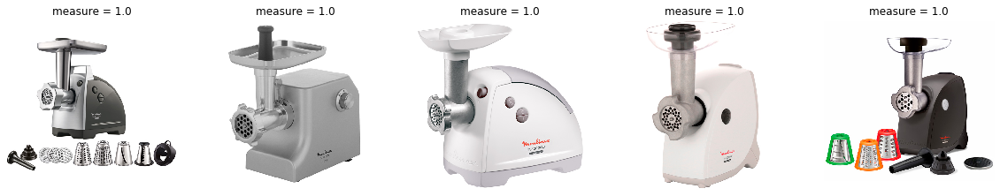

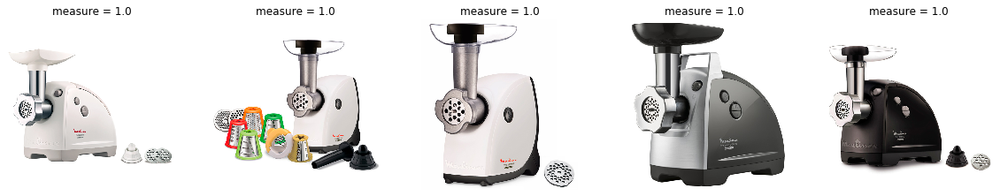

Для пользователя, который взаимодействовал с товарами


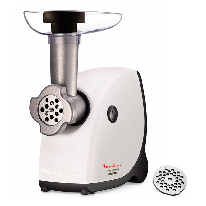

Такие рекомендации


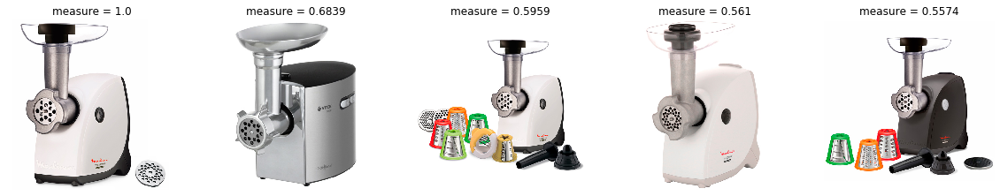

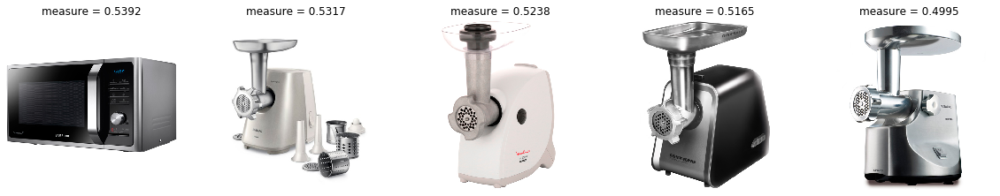

In [217]:
user = 555
CB.get_rec_U2I(user)
w.get_rec_U2I(user)

# Colloborative filtering

In [238]:
# Для простоты положим, что вес у всех типов взаимодействий одинаковый
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 1, 1]})

weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .sum()\
                  .reset_index()

In [239]:
weighted["weight"] = (weighted["weight"] > 0).astype(int)

In [240]:
# заполним sparse матрицу
csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                    shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))

In [241]:
csr_rates

<129920x60080 sparse matrix of type '<class 'numpy.int64'>'
	with 359731 stored elements in COOrdinate format>

In [45]:
user_rates = csr_rates.getrow(12).toarray()[0]

In [49]:
measure = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)

In [83]:
np.sort(measure.ravel())

array([0.        , 0.        , 0.        , ..., 0.81649658, 0.81649658,
       1.        ])

In [84]:
idx = 0

In [85]:
user_rates = csr_rates.getrow(idx).toarray()[0]
watched_items = np.where(user_rates != 0)[0]
metrics = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(csr_rates.copy(), metrics)

In [86]:
user_rates

array([1, 0, 0, ..., 0, 0, 0], dtype=int64)

In [87]:
metrics

array([[1.        ],
       [0.70710678],
       [0.40824829],
       ...,
       [0.        ],
       [0.        ],
       [0.        ]])

In [218]:
ex_df = pd.DataFrame([[1, 0, 0, 1, 0, 0],
              [0, 0, 0, 1, 0, 1],
              [1, 1, 0, 1, 0, 1],
              [0, 0, 0, 0, 1, 1],
              [0, 0, 0, 0, 1, 1],
              [1, 1, 0, 1, 0, 1]], columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

In [219]:
ex_df

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,1,0,0,1,0,0
Петя,0,0,0,1,0,1
Паша,1,1,0,1,0,1
Олег,0,0,0,0,1,1
Марина,0,0,0,0,1,1
Вероника,1,1,0,1,0,1


In [220]:
user_rates = ex_df.iloc[1].values

In [221]:
user_rates

array([0, 0, 0, 1, 0, 1])

In [223]:
metrics = cosine_similarity([user_rates], ex_df.values).reshape(-1, 1)

In [224]:
metrics

array([[0.5       ],
       [1.        ],
       [0.70710678],
       [0.5       ],
       [0.5       ],
       [0.70710678]])

In [225]:
rates = ex_df.values * metrics

In [228]:
pd.DataFrame(rates, columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,0.500000,0.000000,0.0,0.500000,0.0,0.000000
Петя,0.000000,0.000000,0.0,1.000000,0.0,1.000000
Паша,0.707107,0.707107,0.0,0.707107,0.0,0.707107
Олег,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Марина,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Вероника,0.707107,0.707107,0.0,0.707107,0.0,0.707107


In [229]:
total_rate = np.array(np.sum(rates, axis=0))

In [237]:
total_rate

array([1.91421356, 1.41421356, 0.        , 2.91421356, 1.        ,
       3.41421356])

In [77]:
watched_items = np.where(user_rates != 0)[0]

In [243]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        # считаем косинус между товаром idx и всеми пользователями
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [244]:
clb = Colloborative(Int)

Для таких товаров


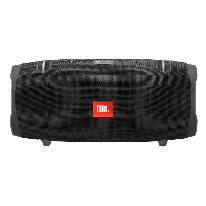

Такие рекомендации


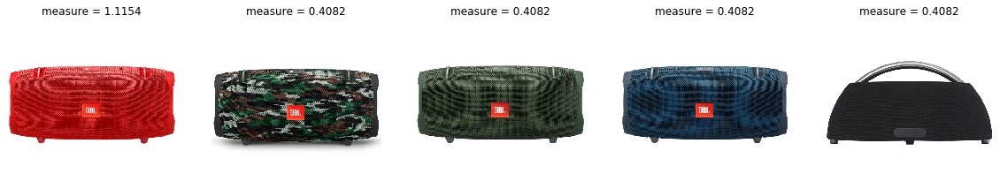

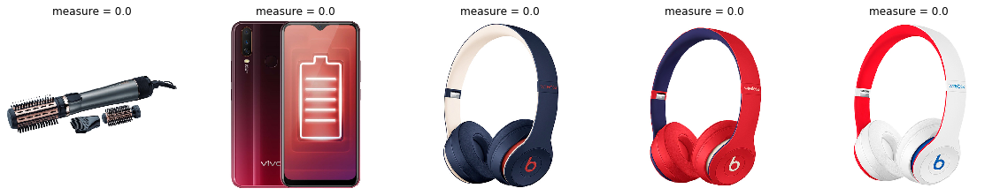

In [246]:
clb.user_based(0)

Для таких товаров


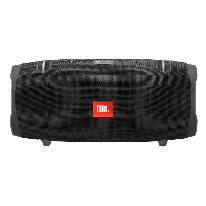

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/10010081b.jpg


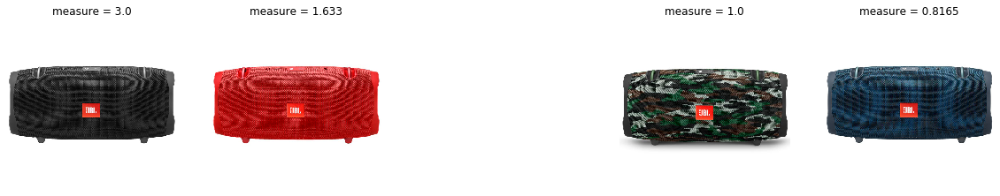

Something went wrong with https://img.mvideo.ru/Pdb/50128992b.jpg


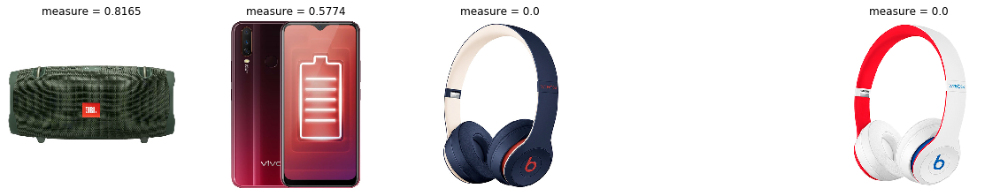

In [247]:
clb.item_based(0)

Для таких товаров


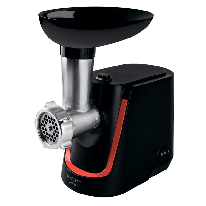

Такие рекомендации


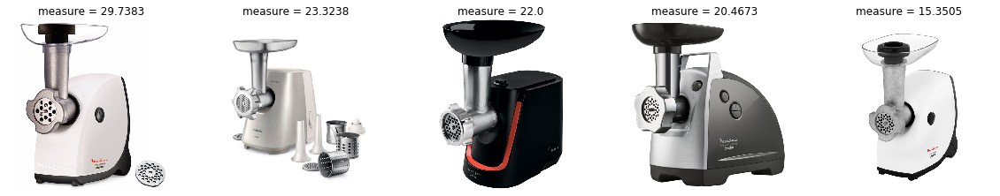

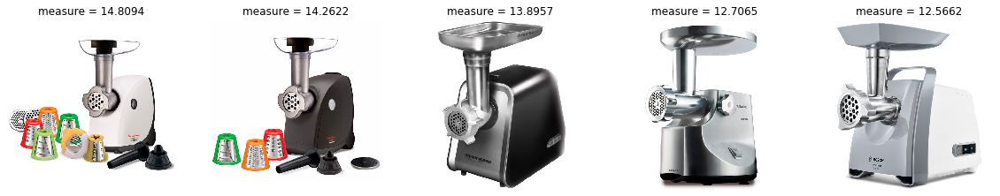

In [248]:
clb.item_based(12)

Для таких товаров


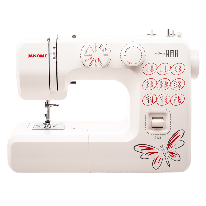

Такие рекомендации


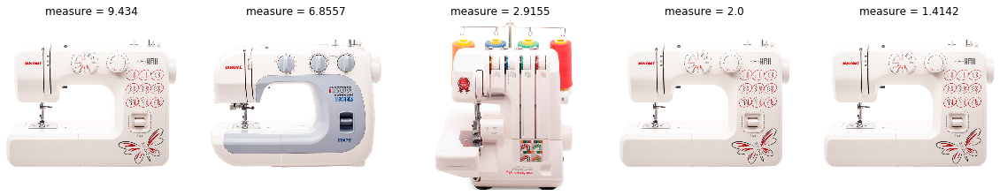

Something went wrong with https://img.mvideo.ru/Pdb/10021610b.jpg


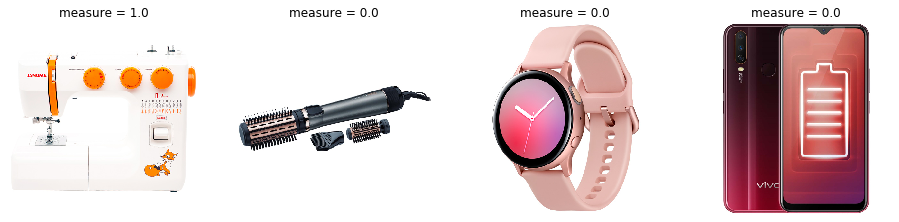

In [250]:
clb.item_based(31211)

Для таких товаров


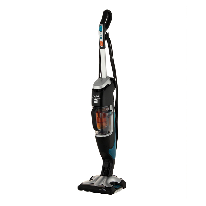

Такие рекомендации


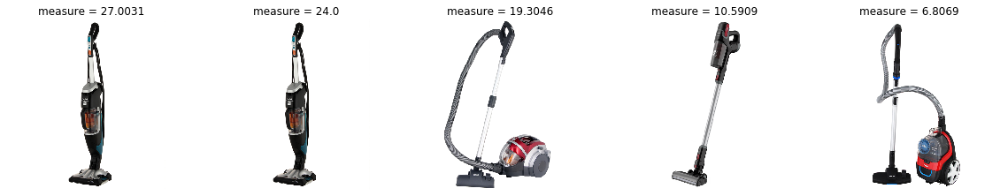

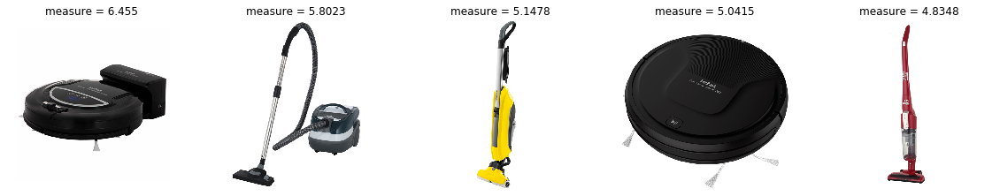

In [251]:
clb.item_based(2556)

Для таких товаров


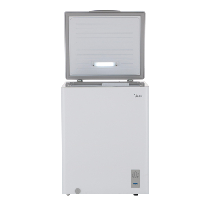

Такие рекомендации


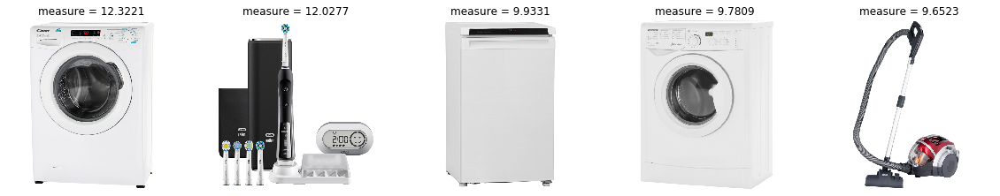

Something went wrong with https://img.mvideo.ru/Pdb/20049026b.jpg


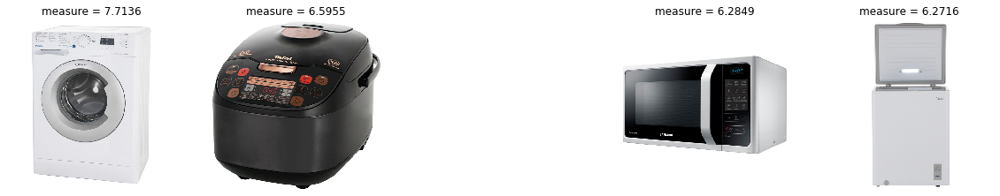

In [253]:
clb.item_based(404)

Для таких товаров


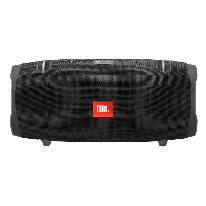

Такие рекомендации


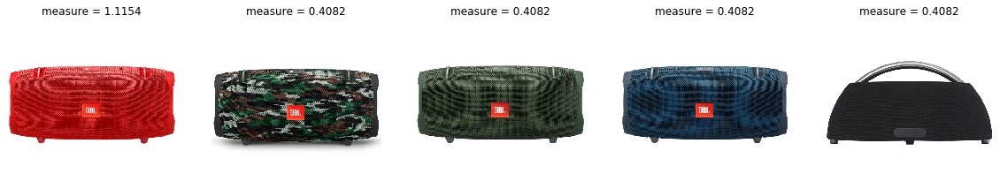

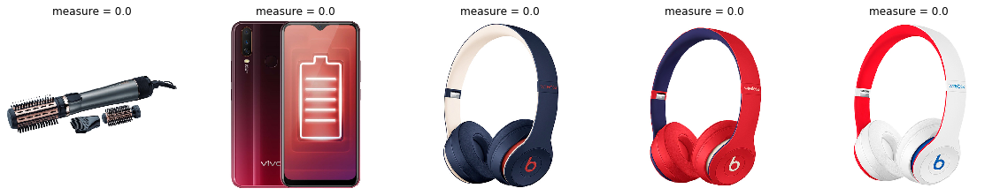

In [254]:
clb.user_based(0)

Для таких товаров


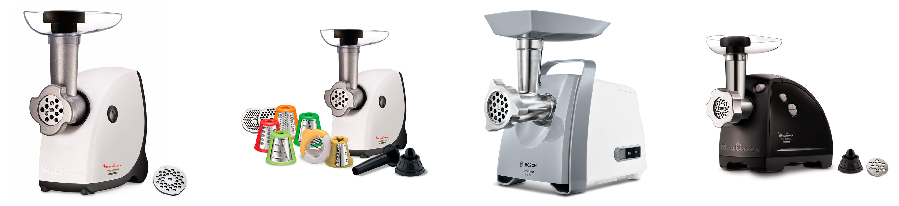

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/20042011b.jpg


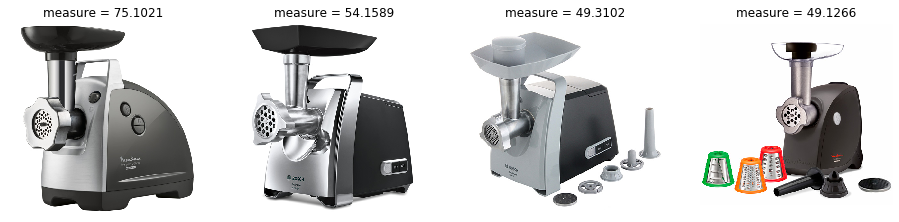

Something went wrong with https://img.mvideo.ru/Pdb/20042189b.jpg


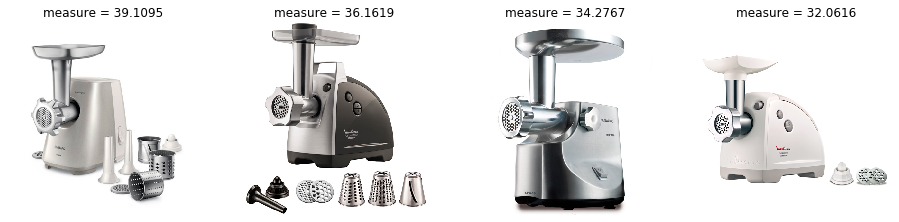

In [257]:
clb.user_based(404)

Для таких товаров


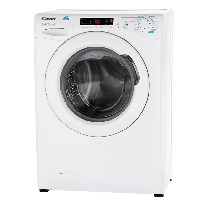

Такие рекомендации


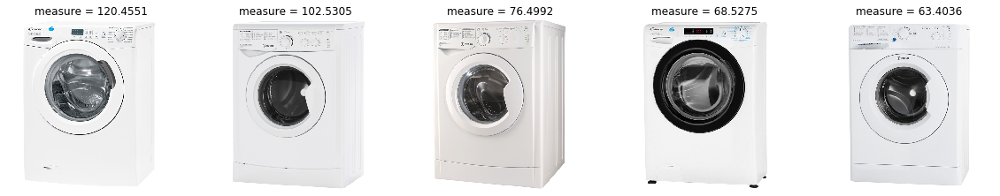

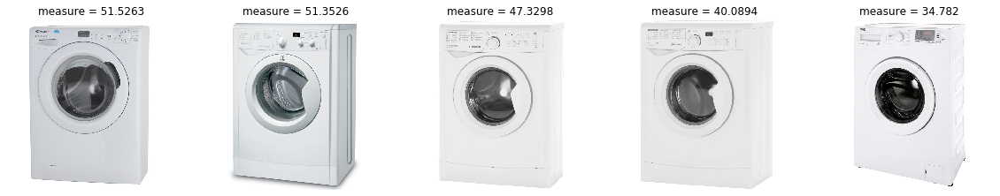

In [258]:
clb.user_based(12345)

Для таких товаров


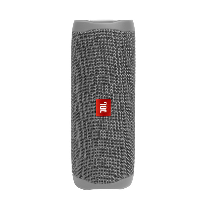

Такие рекомендации


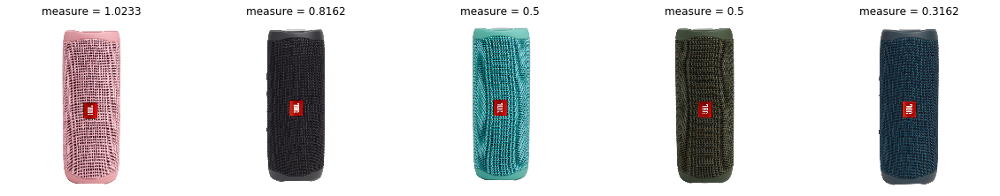

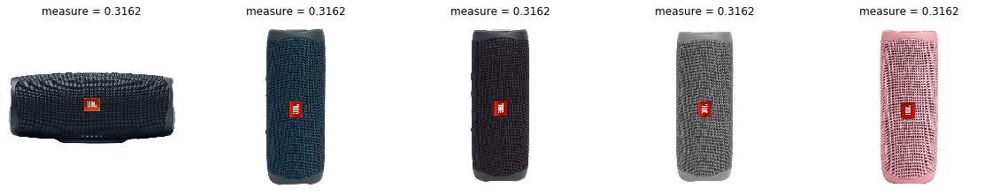

In [259]:
clb.user_based(123456)

Для таких товаров


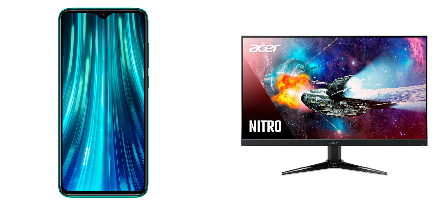

Такие рекомендации


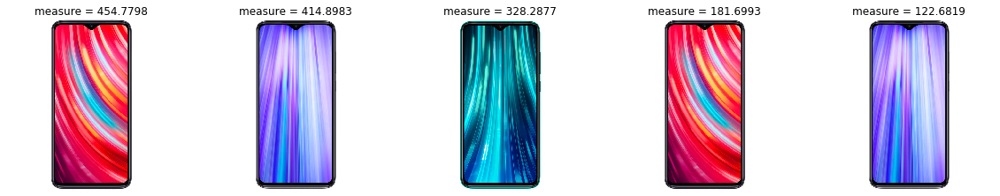

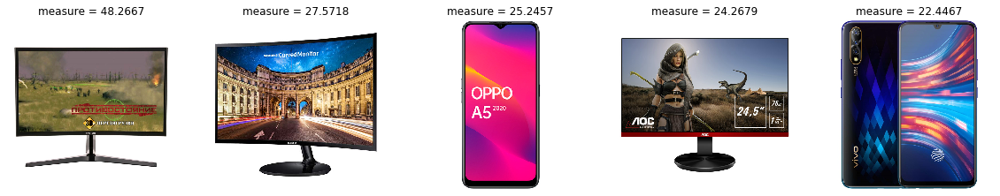

In [260]:
clb.user_based(34434)

Для таких товаров


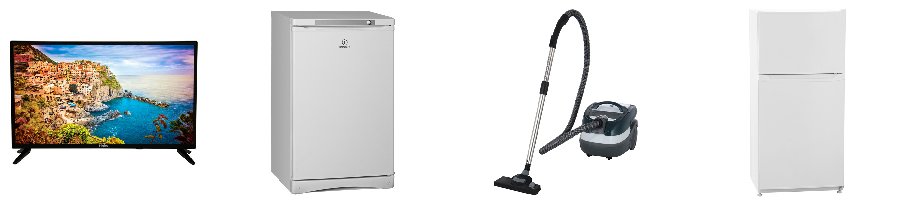

Такие рекомендации


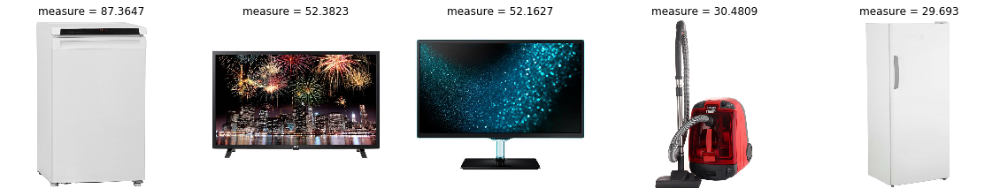

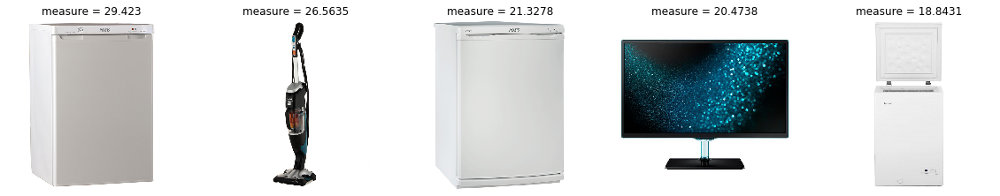

In [261]:
clb.user_based(3333)

Для таких товаров


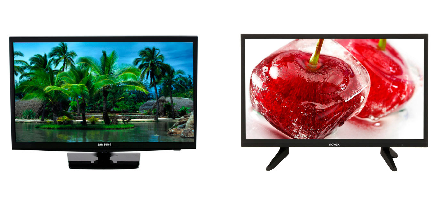

Такие рекомендации


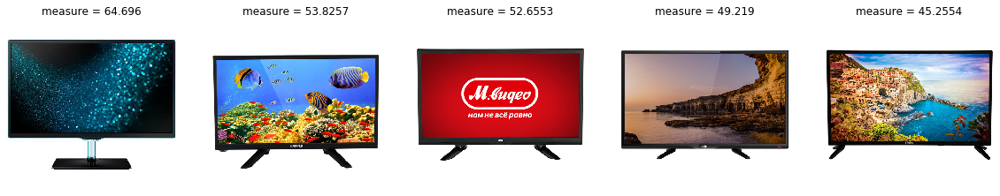

Something went wrong with https://img.mvideo.ru/Pdb/10021266b.jpg


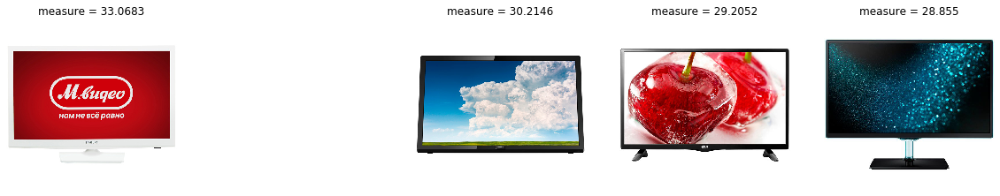

In [262]:
clb.user_based(5555)

Для таких товаров


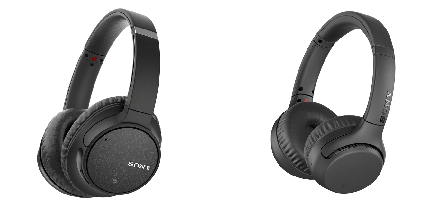

Такие рекомендации


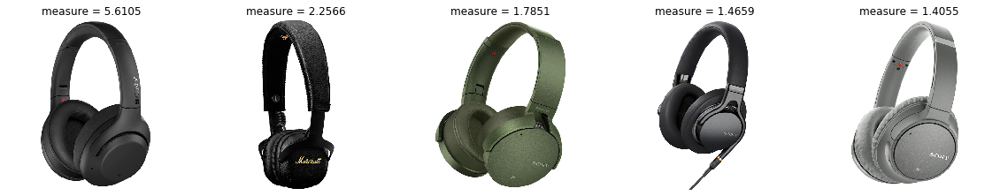

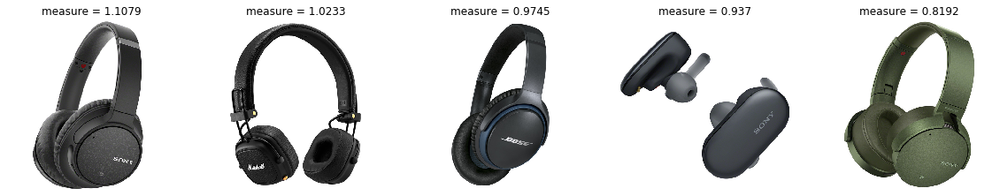

In [263]:
clb.user_based(77777)

Для таких товаров


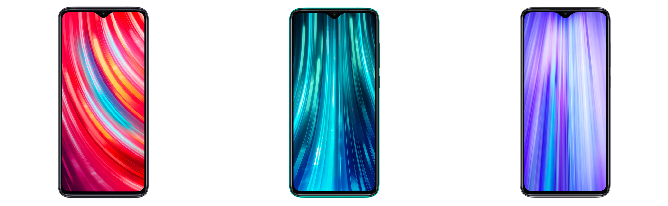

Такие рекомендации


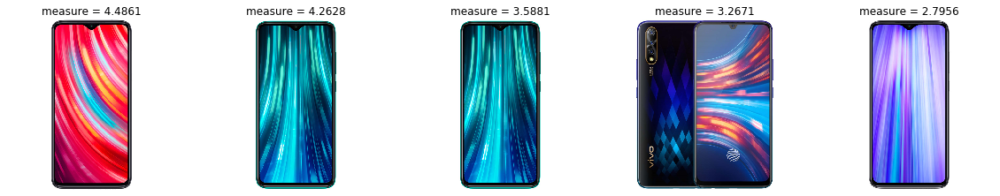

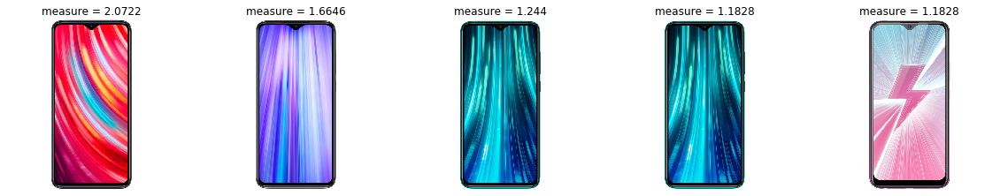

In [264]:
clb.user_based(5)

Для таких товаров


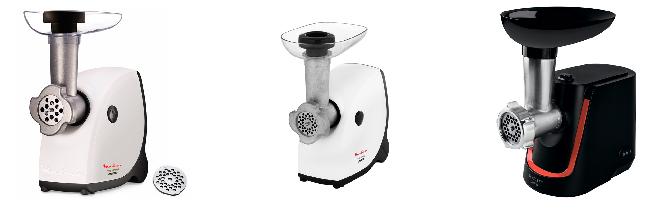

Такие рекомендации


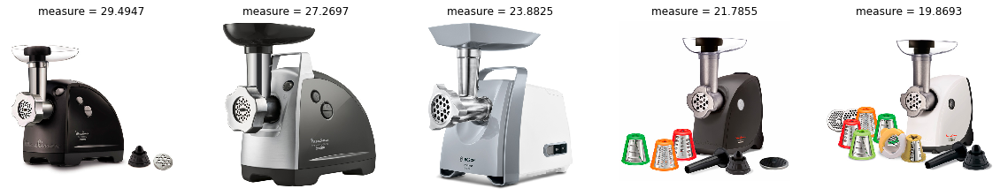

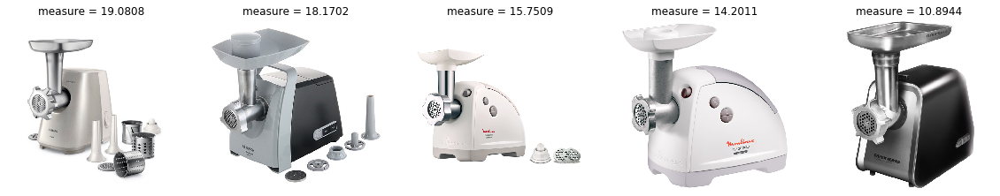

In [265]:
clb.user_based(323)

# Matrix Factorization

In [266]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [267]:
simple_svd = MatrixFactorization(Int, 30)
simple_svd.MF()

Для товара


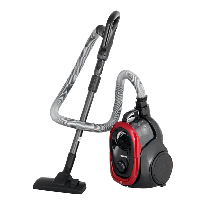

Такие рекомендации


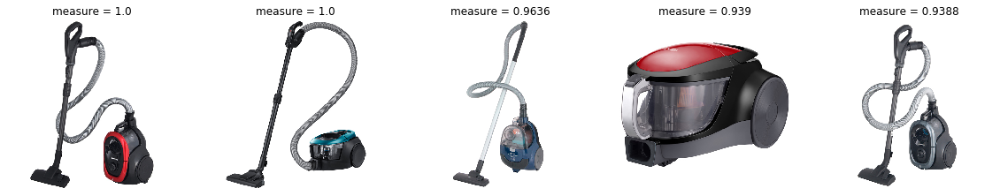

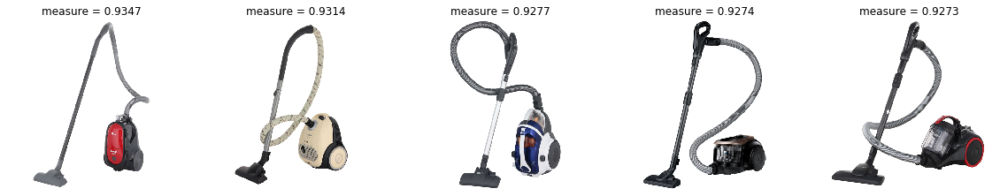

In [270]:
simple_svd.get_rec(122)

Для товара


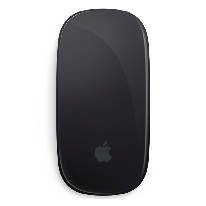

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/50050152b.jpg


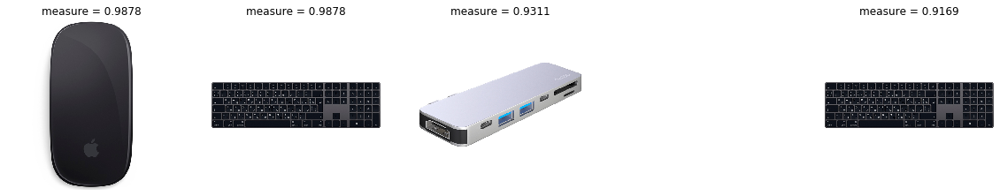

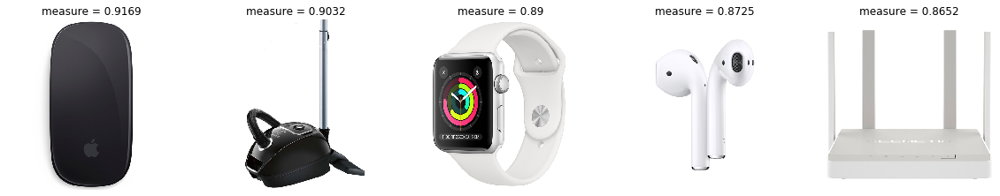

In [271]:
simple_svd.get_rec(402)

Для товара


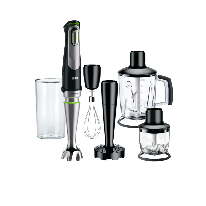

Такие рекомендации


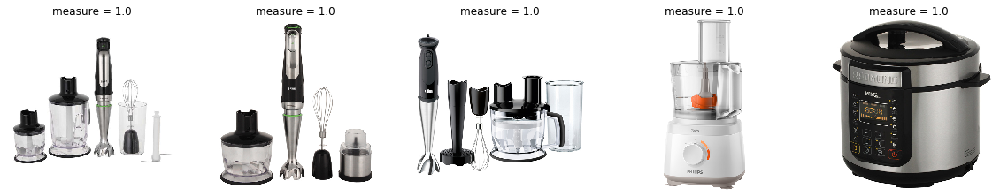

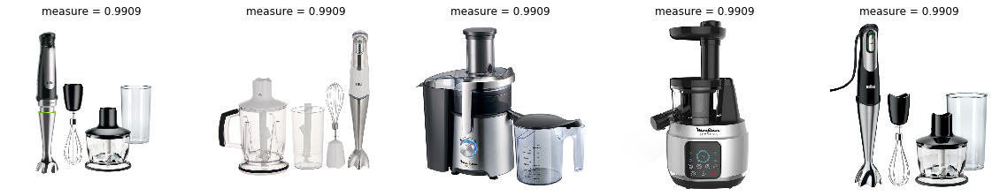

In [272]:
simple_svd.get_rec(10022)

Для товара


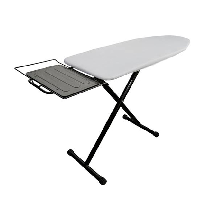

Такие рекомендации


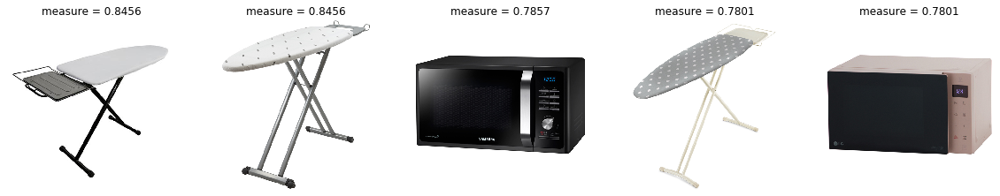

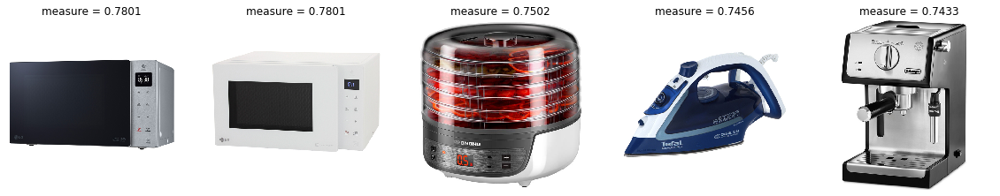

In [280]:
simple_svd.get_rec(406)

# LightFM

In [275]:
mf = MatrixFactorization(Int, 300)
mf.LightFM()

Epoch 0
Epoch 1
Epoch 2
Epoch 3
Epoch 4


Для товара


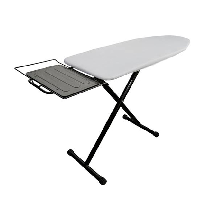

Такие рекомендации


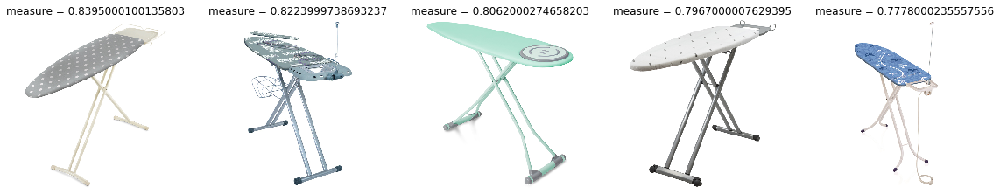

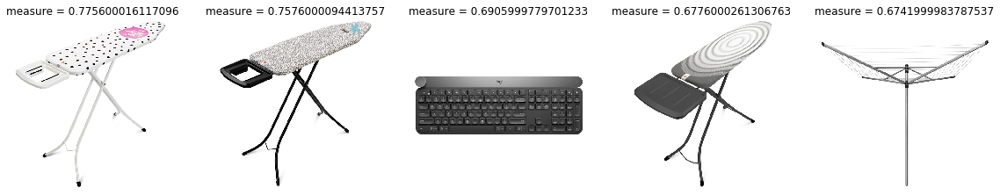

In [279]:
mf.get_rec(406)

Для товара


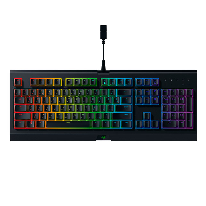

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/50052873b.jpg


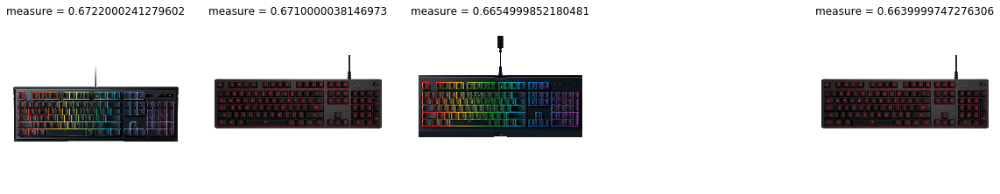

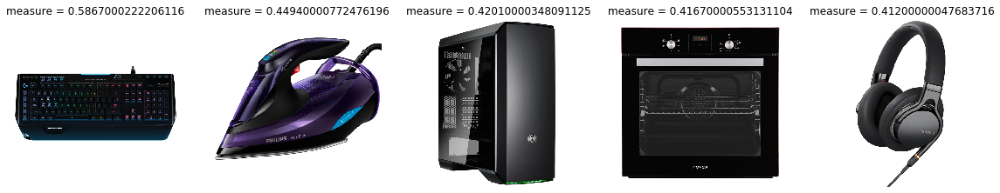

In [277]:
mf.get_rec(1234)

# ALS

$\min\limits_{q^*,p^*}\sum\limits_{u,i}(r_{ui} - q_i^Tp_u)^2 + \lambda(||q_i||^2 + ||p_u||^2)$

In [415]:
LATENT_SIZE = 100

lambda_p = 0.2
lambda_q = 0.01

Посчитаем количество пользователей и товаров

In [416]:
n_users = Int["vid"].value_counts().shape[0]
n_items = Int["product_id"].value_counts().shape[0]

Инициализируем латентные представления для пользователей и товаров

In [417]:
p = 0.1 * np.random.random((n_users, LATENT_SIZE))
q = 0.1 * np.random.random((n_items, LATENT_SIZE))

In [283]:
from collections import defaultdict

In [427]:
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 5, 20]})
weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .max()\
                  .reset_index()

In [281]:
weighted.head()

,vid,product_id,picture_url,weight
0,0,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
1,1,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
2,1,42341,https://img.mvideo.ru/Pdb/10020865b.jpg,1
3,2,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
4,2,37522,https://img.mvideo.ru/Pdb/10018824b.jpg,1


Составим словарь взаимодействий по товару

In [284]:
train_by_item = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_item[i].append((u, r))

Составим словарь взаимодействий по пользователю

In [285]:
train_by_user = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_user[u].append((i, r))

Теперь составим матрицу $P$ из векторов $p_u$ и матрицу Q из векторов $q_i$. Матрицей $Q[u] \in \mathbb{R}^{n_u \times K}$ будем обозначать подматрицу матрицы $Q$ только для товаров, оцененных пользователем $u$, где $n_u$ - количество оценок пользователя $u$.

Шаг перенастройки $p_u$ при фиксированной матрице $Q$ будет выглядеть следующим образом:


$$
A_u = Q[u]^TQ[u]
$$

$$
d_u = Q[u]^Tr_u
$$

$$
p_u = (\lambda_pI + A_u)^{-1}d_u
$$


In [434]:
def compute_p(p, q, train_by_user):
    for u, rated in train_by_user.items():
        rated_items = [i for i, _ in rated]
        Au = q[rated_items].T.dot(q[rated_items])
        ratings = [i for _, i in rated]
        du = q[rated_items].T.dot(ratings)
        p[u] = np.linalg.inv(lambda_p * np.eye(Au.shape[0]) + Au).dot(du)
    return p

Шаг для перенастройки $q_i$ при фиксированной матрице $P$ будет считаться аналогично

In [435]:
def compute_q(p, q, train_by_item):
    for i, rated in train_by_item.items():
        rated_users = [u for u, _ in rated]
        Au = p[rated_users].T.dot(p[rated_users])
        ratings = [u for _, u in rated]
        du = p[rated_users].T.dot(ratings)
        q[i] = np.linalg.inv(lambda_q * np.eye(Au.shape[0]) + Au).dot(du)
    return q

In [287]:
from tqdm.notebook import tqdm_notebook

In [446]:
for i in tqdm_notebook(range(20)):
    p = compute_p(p, q, train_by_user)
    q = compute_q(p, q, train_by_item)

In [454]:
np.save("q.npy", q)

In [288]:
q = np.load("q.npy")

In [290]:
product_id_to_url = {}
for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]

In [291]:
def get_rec_I2I(q, i):
    metrics = cosine_similarity([q[i]], q)
    print(u"Для товара")
    rec_imaging([i], product_id_to_url)
    print(u"Такие рекомендации")
    rec_imaging(np.argsort(metrics)[0][::-1][1:6], product_id_to_url, np.sort(metrics)[0][::-1][1:6])

Для товара


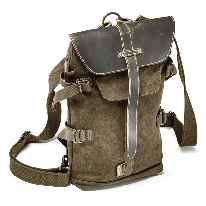

Такие рекомендации


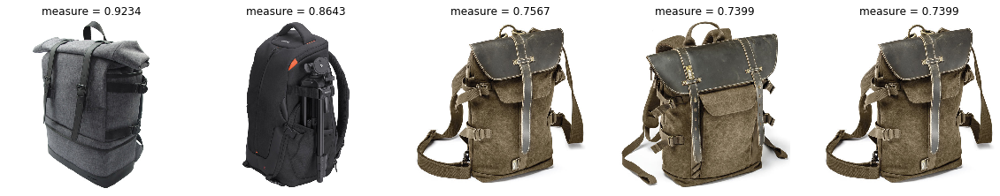

In [292]:
get_rec_I2I(q, 9343)

Для товара


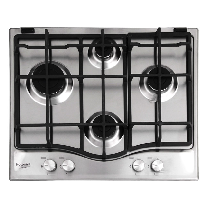

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/20051439b.jpg


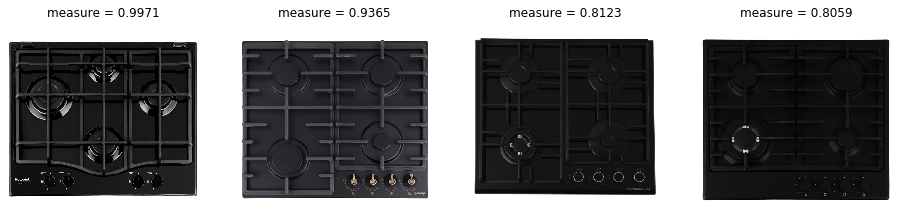

In [295]:
get_rec_I2I(q, 50000)

Для товара


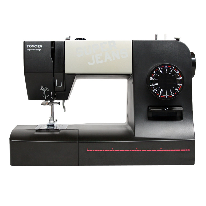

Такие рекомендации


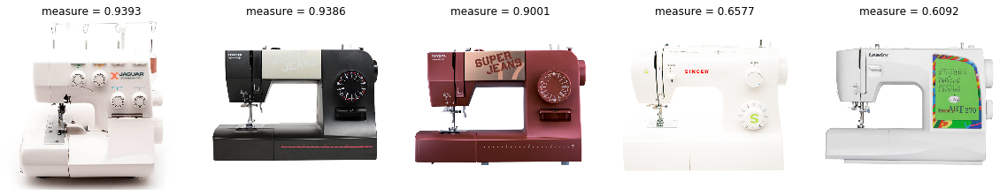

In [296]:
get_rec_I2I(q, 6593)

Для товара


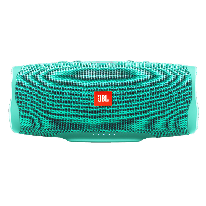

Такие рекомендации
Something went wrong with https://img.mvideo.ru/Pdb/10018414b.jpg


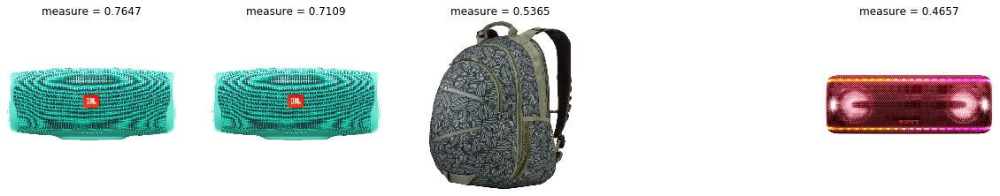

In [297]:
get_rec_I2I(q, 1000)

# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации

Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)

Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Жесткий дедлайн 12 мая

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.

In [2]:
books = pd.read_csv("HW_files/BX-Books.csv")

/Users/emilgrigoryan/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [4]:
interactions = pd.read_csv("HW_files/BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [5]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [6]:
interactions

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
6,276736,3257224281,8
7,276737,0600570967,6
...,...,...,...
1149773,276704,0806917695,5
1149775,276704,1563526298,9
1149777,276709,0515107662,10
1149778,276721,0590442449,10


In [21]:
books

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...
...,...,...,...,...,...,...,...,...
271355,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...
271356,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...
271357,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...
271358,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...


In [22]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [23]:
books_meets

,ISBN,user_num
0,0330299891,1
1,0375404120,1
2,9022906116,1
3,#6612432,1
4,'9607092910',1
...,...,...
185968,"\8888809228\""""",1
185969,"\9170010242\""""",1
185970,ooo7156103,1
185971,´3499128624,1


In [ ]:
inter = interactions.drop_duplicates()

In [ ]:
user_products = inter.groupby(["User-ID"])["ISBN"].apply(list).reset_index()

In [24]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [37]:
user_meets

,User-ID,books_num
0,8,7
1,9,1
2,10,1
3,12,1
4,14,3
...,...,...
77800,278846,1
77801,278849,1
77802,278851,14
77803,278852,1


In [25]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [26]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [28]:
users = pd.read_csv('HW_files/BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [29]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [30]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [31]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [ ]:
interactions.head()

In [33]:
csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

### Ищем id нужных книг

In [34]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "David Copperfield" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 10174 	Book Title: David Copperfield (Wordsworth Classics)
idx: 1074 	Book Title: David Copperfield (Penguin Classics)


In [42]:
interactions

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
6,276736,3257224281,8
7,276737,0600570967,6
...,...,...,...
1149773,276704,0806917695,5
1149775,276704,1563526298,9
1149777,276709,0515107662,10
1149778,276721,0590442449,10


In [ ]:
user_products["prod_num"] = product_num

In [ ]:
cooc = {}
for i in tqdm.notebook.tqdm(user_products.values):
    for j in range(len(i[1])):
        for k in range(len(i[1])):
            if j != k:
                try:
                    W = (int(inter[(inter[i] == 276729) & (inter[j] == "052165615X")]["Book-Rating"]) +
                           int(inter[(inter[i] == 276729) & (inter[k] == "052165615X")]["Book-Rating"])) / 2
                    cooc[str(i[1][j]) + "_" + str(i[1][k])] = cooc[str(i[1][j]) + "_" + str(i[1][k])] + w + 1
                except:
                    cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
cooc_list = []
for i, j in cooc.items():
    if j != 1:
        cooc_list.append(i.split("_") + [j])
cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])